In [1]:
import pandas as pd
import numpy as np
import os

from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA

from matplotlib import pyplot as plt
# do the inline thing
%matplotlib inline

import seaborn as sns
import altair as alt
from altair_saver import save

from lcfunctions import download_lasair_lc, display_lightcurve
from lcfunctions import lasair_clean, load_lasair_lc
from outlier import iqr_method, reorder_cols

from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer


### Dataset and preprocessing

In [6]:
cvlistdate = '21032023'
lightcurvesdate = '08102023'
label_scheme = 'labels_1'
gaia = False

pd.options.display.max_columns = None

dataset = pd.read_csv(f'../processed_data/dataset_{cvlistdate}allfeatures_inc_labels{lightcurvesdate}.csv', low_memory=False)
dataset = dataset[dataset[label_scheme].notna()].reset_index(drop=True)
# drop rows with no Gaia data
# dataset = dataset[dataset['ra_error'].notna()].reset_index(drop=True)
# dataset = dataset[dataset['absmag_g'].notna()].reset_index(drop=True)

# Drop Gaia features
if gaia == False:
    dataset = dataset.iloc[:,:-34]

# Filter dataset
dataset_pts_threshold = dataset[(dataset['n_obs_g']>=20) | (dataset['n_obs_r']>=20)].reset_index(drop=True)
# dataset_timespan_threshold = dataset[dataset['temporal_baseline_g']>=365].reset_index(drop=True)

# Dataset going forward
dataset_final = dataset_pts_threshold

print(dataset_final[label_scheme].value_counts())

X = dataset_final.iloc[:,14:]
X_cols = X.columns.tolist()
y_names = dataset_final[label_scheme]
enc = LabelEncoder()
y = enc.fit_transform(y_names)
print(X.shape, y.shape, len(X_cols))

# Handle outliers
cap_cols1 = ['Period_fit_g','Period_fit_r']
cap_cols2 = ['pwr_max_g','pwr_max_r']
cap_cols3 = ['distance']

iqr_cols1 = ['LinearTrend_g','LinearTrend_r']
iqr_cols2 = ['clr_mean','clr_median', 'clr_bright','clr_faint']
iqr_cols3 = ['astrometric_sigma5d_max']
iqr_cols4 = ['bp_rp','bp_g','g_rp']
iqr_cols5 = ['absmag_g','absmag_bp','absmag_rp']

log_cols = ['Autocor_length_g','CAR_mean_g','CAR_sigma_g','Eta_e_g',
            'Freq1_harmonics_amplitude_0_g','Freq1_harmonics_amplitude_1_g',
            'Freq1_harmonics_amplitude_2_g','Freq1_harmonics_amplitude_3_g',
            'Freq2_harmonics_amplitude_0_g','Freq2_harmonics_amplitude_1_g',
            'Freq2_harmonics_amplitude_2_g','Freq2_harmonics_amplitude_3_g',
            'Freq3_harmonics_amplitude_0_g','Freq3_harmonics_amplitude_1_g',
            'Freq3_harmonics_amplitude_2_g','Freq3_harmonics_amplitude_3_g',
            'MaxSlope_g','PeriodLS_g','SlottedA_length_g',
            'Autocor_length_r','CAR_mean_r','CAR_sigma_r','Eta_e_r',
            'Freq1_harmonics_amplitude_0_r','Freq1_harmonics_amplitude_1_r',
            'Freq1_harmonics_amplitude_2_r','Freq1_harmonics_amplitude_3_r',
            'Freq2_harmonics_amplitude_0_r','Freq2_harmonics_amplitude_1_r',
            'Freq2_harmonics_amplitude_2_r','Freq2_harmonics_amplitude_3_r',
            'Freq3_harmonics_amplitude_0_r','Freq3_harmonics_amplitude_1_r',
            'Freq3_harmonics_amplitude_2_r','Freq3_harmonics_amplitude_3_r',
            'MaxSlope_r','PeriodLS_r','SlottedA_length_r'
            ]

log_cols2 = ['freq_pwr_max_g','pwr_maxovermean_g',
             'npeaks_pt5to1_g','rrate_pt5to1_g','drate_pt5to1_g', 
             'npeaks_1to2_g','rrate_1to2_g','drate_1to2_g',
             'npeaks_2to5_g','rrate_2to5_g','drate_2to5_g',
             'npeaks_above5_g','rrate_above5_g','drate_above5_g',
             'rollstd_ratio_t20s10_g','rollstd_ratio_t10s5_g',
             'pnts_leq_rollMedWin20-1mag_g','pnts_leq_rollMedWin20-2mag_g','pnts_leq_rollMedWin20-5mag_g',
             'pnts_geq_rollMedWin20+1mag_g','pnts_geq_rollMedWin20+2mag_g','pnts_geq_rollMedWin20+3mag_g',
             'pnts_leq_median-1mag_g','pnts_leq_median-2mag_g','pnts_leq_median-5mag_g',
             'pnts_geq_median+1mag_g','pnts_geq_median+2mag_g','pnts_geq_median+3mag_g',
             'freq_pwr_max_r','pwr_maxovermean_r',
             'npeaks_pt5to1_r','rrate_pt5to1_r','drate_pt5to1_r',
             'npeaks_1to2_r','rrate_1to2_r','drate_1to2_r',
             'npeaks_2to5_r','rrate_2to5_r','drate_2to5_r',
             'npeaks_above5_r','rrate_above5_r','drate_above5_r',
             'rollstd_ratio_t20s10_r','rollstd_ratio_t10s5_r',
             'pnts_leq_rollMedWin20-1mag_r','pnts_leq_rollMedWin20-2mag_r','pnts_leq_rollMedWin20-5mag_r',
             'pnts_geq_rollMedWin20+1mag_r','pnts_geq_rollMedWin20+2mag_r','pnts_geq_rollMedWin20+3mag_r',
             'pnts_leq_median-1mag_r','pnts_leq_median-2mag_r','pnts_leq_median-5mag_r',
             'pnts_geq_median+1mag_r','pnts_geq_median+2mag_r','pnts_geq_median+3mag_r'
             ]

log_cols3 = ['ra_error','dec_error',
            'parallax_error',
            'pm',
            'pmra_error',
            'pmdec_error',
            'phot_g_mean_flux',
            'phot_g_mean_flux_error',
            'phot_bp_mean_flux',
            'phot_bp_mean_flux_error',
            'phot_rp_mean_flux',
            'phot_rp_mean_flux_error',
            'distance'
            ]


log_transformer1 = FunctionTransformer(np.log1p, validate=False)
log_transformer2 = FunctionTransformer(np.log1p, validate=False)
log_transformer3 = FunctionTransformer(np.log1p, validate=False)

cap_transformer1 = FunctionTransformer(np.clip, validate=False, kw_args={'a_min':0, 'a_max':1})
cap_transformer2 = FunctionTransformer(np.clip, validate=False, kw_args={'a_min':0, 'a_max':1})
cap_transformer3 = FunctionTransformer(np.clip, validate=False, kw_args={'a_min':0, 'a_max':np.inf})

iqr_transformer1 = FunctionTransformer(iqr_method, validate=False, kw_args={'factor': 5})#5
iqr_transformer2 = FunctionTransformer(iqr_method, validate=False, kw_args={'factor': 2})#2
iqr_transformer3 = FunctionTransformer(iqr_method, validate=False, kw_args={'factor': 10})#10
iqr_transformer4 = FunctionTransformer(iqr_method, validate=False, kw_args={'factor': 2}) #2
iqr_transformer5 = FunctionTransformer(iqr_method, validate=False, kw_args={'factor': 3})#3


if gaia == True:
    preprocessor = ColumnTransformer(
        transformers=[
            ('cap', cap_transformer1, cap_cols1),
            ('cap2', cap_transformer2, cap_cols2),
            # ('cap3', cap_transformer3, cap_cols3),
            ('iqr1', iqr_transformer1, iqr_cols1),
            ('iqr2', iqr_transformer2, iqr_cols2),
            ('iqr3', iqr_transformer3, iqr_cols3),
            ('iqr4', iqr_transformer4, iqr_cols4),
            ('iqr5', iqr_transformer5, iqr_cols5),
            ('log_transform1', log_transformer1, log_cols),
            ('log_transform2', log_transformer2, log_cols2),
            ('log_transform3', log_transformer3, log_cols3)
        ],
        remainder='passthrough',  # Pass through columns not specified in transformers
        verbose_feature_names_out=False).set_output(transform='pandas'
    )
elif gaia == False:
    preprocessor = ColumnTransformer(
        transformers=[
            ('cap', cap_transformer1, cap_cols1),
            ('cap2', cap_transformer2, cap_cols2),
            ('iqr1', iqr_transformer1, iqr_cols1),
            ('iqr2', iqr_transformer2, iqr_cols2),
            ('log_transform1', log_transformer1, log_cols),
            ('log_transform2', log_transformer2, log_cols2)
        ],
        remainder='passthrough',  # Pass through columns not specified in transformers
        verbose_feature_names_out=False).set_output(transform='pandas'
    )



labels_1
dwarf_nova_SU_UMa    378
dwarf_nova_Z_Cam     168
nova_like            138
nova_like_VY_Scl     117
dwarf_nova_U_Gem     115
polar                110
int_polar             49
AMCVn                 35
dwarf_nova_WZ_Sge     32
nova                  27
dwarf_nova_ER_UMa     25
Name: count, dtype: int64
(1194, 222) (1194,) 222


/Users/aridmist/opt/anaconda3/envs/mainenv/lib/python3.10/site-packages/sklearn/preprocessing/_function_transformer.py:345: UserWarning: With transform="pandas", `func` should return a DataFrame to follow the set_output API.
  warnings.warn(


### Perform PCA

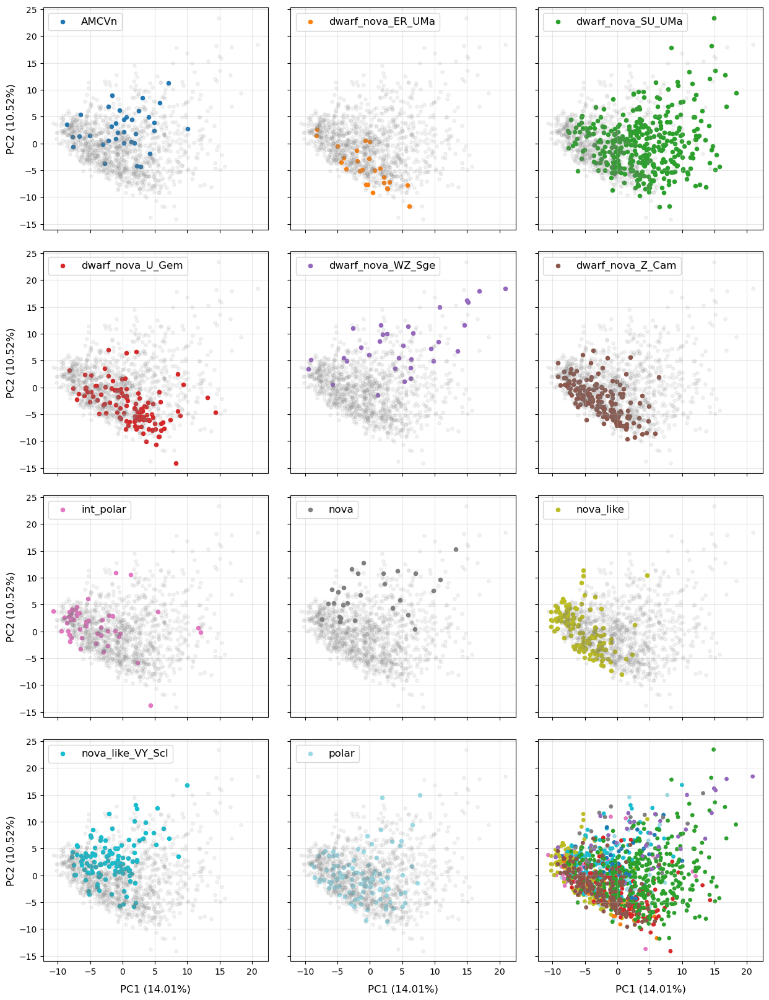

alt.Chart(...)

In [7]:
# PCA
pca = PCA(n_components=2)
scaler = StandardScaler()
imputer = KNNImputer(n_neighbors=5)
minmax = MinMaxScaler()


pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('reorder_cols', FunctionTransformer(reorder_cols, kw_args={'cols':X_cols})),
    ('scaler', scaler),
    ('imputer', imputer),
    # ('minmax', minmax),
    ('pca', pca)
])


# Fit and transform the data using the pipeline
pipeline.fit(X)

# Save the pipeline
import pickle
if gaia == True:
    with open(f'../results/model/model_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_gaia.pkl', 'wb') as f:
        pickle.dump(pipeline, f)
elif gaia == False:
    with open(f'../results/model/model_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_lconly.pkl', 'wb') as f:
        pickle.dump(pipeline, f)


X_pca = pipeline.transform(X)
# Get the explained variance ratio from the PCA step
exp_var = pipeline.named_steps['pca'].explained_variance_ratio_

# Plot PCA using altair
transformed_data = pipeline.named_steps['preprocessor'].transform(X)
transformed_data_test = pipeline.named_steps['preprocessor'].transform(X)
transformed_data = pipeline.named_steps['reorder_cols'].transform(transformed_data)
transformed_data = pipeline.named_steps['scaler'].transform(transformed_data)
transformed_data = pipeline.named_steps['imputer'].transform(transformed_data)
df_pca_X = pd.DataFrame(transformed_data, columns=X_cols)
#Re-scale features using min-max scaler
scaler3 = MinMaxScaler()
df_pca_X[X_cols] = scaler3.fit_transform(df_pca_X[X_cols])

df_pca_X = pd.concat([df_pca_X, 
                      pd.Series(dataset_final.index, name='index'), 
                      dataset_final[['oid_ztf','type_aavso']],
                      pd.Series(X_pca[:,0], name='PC1'), 
                      pd.Series(X_pca[:,1], name='PC2'),
                      pd.Series(y_names, name='label')
                      ],
                      axis=1)

selection = alt.selection_point(fields=['label'], bind='legend')

projection_full = alt.Chart(df_pca_X, width=400, height=400).mark_square(size=30).encode(
    x=alt.X('PC1', title=f'PC1 ({exp_var[0]*100:.2f}%)'),
    y=alt.Y('PC2', title=f'PC2 ({exp_var[1]*100:.2f}%)'),
    color=alt.Color(shorthand='label', title='Class',
                    # Select a colour scheme for the classes where the colours are distinct, and more than 11 classes
                    scale=alt.Scale(domain=np.unique(y_names).tolist(),
                                    scheme='category20',
                                    # range=clr_range
                                    )),
    tooltip=['label', 'index','oid_ztf', 'type_aavso'],
    opacity=alt.condition(selection, alt.value(0.8), alt.value(0.1))
).add_params(selection).interactive()

projection_full.title = 'PCA Projection of Full Dataset'

# Use matplotlib subplots to plot one class versus the rest for each of the classes, where the last subplot is all the classes.
fig, ax = plt.subplots(4, 3, figsize=(15,20), sharex=True, sharey=True)
ax = ax.flatten()
# use the cmap tab20 for the first 11 classes
c = plt.cm.tab20(np.linspace(0,1,11))
# can you perform the above as a list of colours from tab20?

for i in range(11):
    # use the color keyword argument to set the colour of the points instead of c
    ax[i].scatter(X_pca[y==i,0], X_pca[y==i,1], label=enc.inverse_transform([i])[0], s=20, color=c[i])
    ax[i].scatter(X_pca[y!=i,0], X_pca[y!=i,1], c='grey', s=15, alpha=0.1)
    ax[i].grid(alpha=0.3)
    if i in [0,3,6,9]:
        ax[i].set_ylabel(f'PC2 ({exp_var[1]*100:.2f}%)', fontsize=12)
    if i in [9,10]:
        ax[i].set_xlabel(f'PC1 ({exp_var[0]*100:.2f}%)', fontsize=12)
        # pad the x-axis label up a bit
        ax[i].xaxis.labelpad = 10
    ax[i].legend(fontsize=12)
    
# Use the class colours for the last subplot
ax[11].scatter(X_pca[:,0], X_pca[:,1], s=15, alpha=1, c=y, cmap='tab20')
ax[11].set_xlabel(f'PC1 ({exp_var[0]*100:.2f}%)', fontsize=12)
ax[11].xaxis.labelpad = 10
ax[11].grid(alpha=0.3)
# reduce the gaps between subplots
plt.subplots_adjust(hspace=0.1, wspace=0.1)
# plt.tight_layout()
if gaia == True:
    plt.savefig(f'../results/figures/unsupervised/projection_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_20gor20r_gaia.pdf', bbox_inches='tight')
elif gaia == False:
    plt.savefig(f'../results/figures/unsupervised/projection_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_20gor20r_lconly.pdf', bbox_inches='tight')
plt.show()

projection_full


### Feature Maps

In [9]:


def plot_factor_map(df_map, feature,fig_size=(150,150),node_size=1):
    #df_map['size']=df_map['size']*node_size
    return alt.Chart(df_map).mark_square().encode(
        x=alt.X('PC1',axis=None),
        y=alt.Y('PC2',axis=None),
        color=alt.Color(f'{feature}:Q',
                        scale=alt.Scale(scheme='turbo'),
                        title='Scale'),
        size=alt.value(10),
        tooltip=[f'{feature}:Q','index','oid_ztf','label','type_aavso'],
        #opacity='density'
        # increase title font size
    ).properties(title=[feature[0:17], feature[17:34]], width=fig_size[0], height=fig_size[1])


varnames = ['Amplitude_g', 'Meanvariance_g', 'Std_g', 'dif_max_min_g',
            'npeaks_pt5to1_g', 'npeaks_1to2_g', 'npeaks_2to5_g', 'npeaks_above5_g',
            'amp_pt5to1_g', 'amp_1to2_g', 'amp_2to5_g', 'amp_above5_g',
            'Freq1_harmonics_amplitude_0_g', 'Freq1_harmonics_amplitude_1_g',
            'Freq1_harmonics_amplitude_2_g', 'Freq1_harmonics_amplitude_3_g',
            'Freq2_harmonics_amplitude_0_g', 'Freq2_harmonics_amplitude_1_g',
            'Freq2_harmonics_amplitude_2_g', 'Freq2_harmonics_amplitude_3_g',
            'Freq3_harmonics_amplitude_0_g', 'Freq3_harmonics_amplitude_1_g',
            'Freq3_harmonics_amplitude_2_g', 'Freq3_harmonics_amplitude_3_g',
            'PeriodLS_g', 'n_obs_g', 'Rcs_g', 'Psi_CS_g', 'MaxSlope_g','LinearTrend_g',
            'clr_mean', 'clr_median', 'clr_bright', 'clr_faint'
            ]
# varnames = ['ra_error', 'dec_error', 'parallax', 'parallax_error', 'pm', 'pmra_error', 'pmdec_error',
#             'nu_eff_used_in_astrometry', 'phot_g_mean_flux',
#             'phot_g_mean_flux_error', 'phot_g_mean_mag', 'phot_bp_mean_flux', 'phot_bp_mean_flux_error',
#             'phot_bp_mean_mag', 'phot_rp_mean_flux', 'phot_rp_mean_flux_error', 'phot_rp_mean_mag',
#             'bp_rp', 'bp_g', 'g_rp', 'b', 'distance', 'absmag_g', 'absmag_bp', 'absmag_rp'
# ]

varnames = ['Amplitude_g', 'Freq1_harmonics_amplitude_0_g', 
            'Gskew_g','LinearTrend_g','MaxSlope_g',
            'PeriodLS_g','Psi_CS_g','Psi_eta_g','Rcs_g','Std_g','StetsonL','min_mag_g',
            'max_mag_g','n_obs_g','dif_max_median_g','temporal_baseline_g','pwr_max_g',
            'npeaks_pt5to1_g', 'npeaks_1to2_g', 'npeaks_2to5_g', 'rrate_2to5_g', 
            'drate_2to5_g', 'amp_2to5_g', 'npeaks_above5_g','rollstd_ratio_t20s10_g', 'stdstilllev_t20s10_g',
            'pnts_leq_rollMedWin20-1mag_g', 'pnts_leq_rollMedWin20-2mag_g',
            'pnts_leq_rollMedWin20-5mag_g', 'pnts_geq_rollMedWin20+1mag_g', 'pnts_geq_rollMedWin20+2mag_g', 
            'pnts_geq_rollMedWin20+3mag_g', 'clr_mean', 'clr_bright', 'clr_faint'
 ]

# varnames = X_cols

# Plot individual features along with histogram
# varnames = ['clr_mean']
# dataset_final[varnames].hist(bins=100)

var = 0

# %%
chart = alt.vconcat()
new_line = '\n'
for rr in range(100):
    row = alt.hconcat()
    for cc in range(5):
        if var<len(varnames):
            row |= plot_factor_map(
                df_pca_X, 
                varnames[var])
            var = var + 1
    chart &= row


# if gaia == True:
#     chart.save(f'../results/figures/unsupervised/featureprojection_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_20gor20r_gaia.png')
#     # save(chart, f'../results/figures/unsupervised/featureprojection_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_20gor20r_gaia.png')
# elif gaia == False:
#     chart.save(f'../results/figures/unsupervised/featureprojection_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_20gor20r_lconly.png')
#     # save(chart, f'../results/figures/unsupervised/featureprojection_pca_cvlist{cvlistdate}_lcdata{lightcurvesdate}_20gor20r_lconly.png')

# adjust padding between subplots

chart.configure_concat(spacing=10).configure_view(strokeWidth=1).configure_axis(grid=False).configure_title(fontSize=14).configure_legend(titleFontSize=12, labelFontSize=12)


alt.VConcatChart(...)

### Display light curve of object

In [7]:
# Display lasair difference magnitude and apparent magnitude light curves.
index = 672
objects = [dataset_final.iloc[index,:]['oid_ztf']]
manual_label = dataset_final.iloc[index,:]['labels_1']
oid_aavso = dataset_final.iloc[index,:]['oid_aavso']
type_aavso = dataset_final.iloc[index,:]['type_aavso']

print(objects)
print(manual_label, oid_aavso, type_aavso)
date = '08102023'

# Apply errorbars
error = False

if error == True:
        errColalerce1 = 'sigmapsf'
        errColalerce2 = 'sigmapsf_corr_revised'
        errCollasair1 = 'sigmapsf'
        errCollasair2 = 'dc_sigmag'
else:
    errColalerce1 = None
    errColalerce2 = None
    errCollasair1 = None
    errCollasair2 = None

for object in objects:
    try:
        lc_lasair = load_lasair_lc(object, path=f'../lightcurves_dataset/lasair_{date}')
    except:
        # Create a folder within path for LCs if one does not exist
        if not os.path.exists(f'../lightcurves_dataset/lasair_non_dataset/cache'):
            os.makedirs(f'../lightcurves_dataset/lasair_non_dataset/cache')
        print('Not in dataset')
        download_lasair_lc([object], folderpath=f'../lightcurves_dataset/lasair_non_dataset', cache=f'../lightcurves_dataset/lasair_non_dataset/cache')
        lc_lasair = load_lasair_lc(object, path=f'../lightcurves_dataset/lasair_non_dataset')

    lc_lasair_appmag = lasair_clean(lc_lasair, limit=25, magerrlim=1)

    # print('Lasair difference magnitude')
    # display_lightcurve(lc_lasair,x='jd',y='magpsf',errorCol=errCollasair1)
    print('Lasair apparent magnitude')
    display_lightcurve(lc_lasair_appmag,x='jd',y='dc_mag',errorCol=errCollasair2)

['ZTF18acadvne']
dwarf_nova_SU_UMa ASASSN-14dh UGSU
Lasair apparent magnitude
